<a href="https://colab.research.google.com/github/Untick/insects_detection/blob/main/Romashenkov%20Leonid/LR_insects_detection_006.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Подключение библиотек и Google диска

In [ ]:
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, ZeroPadding2D, Add, UpSampling2D, Concatenate, Lambda, LeakyReLU # Стандартные слои Keras
from tensorflow.keras.regularizers import l2 # Регуляризатор l2
from tensorflow.keras.optimizers import Adam # Оптимизатор Adam
from tensorflow.keras.models import Model # Абстрактный класс Model
from PIL import Image, ImageDraw, ImageFont # Модули работы с изображениями
from matplotlib.colors import rgb_to_hsv, hsv_to_rgb # Модули конвертации между RGB и HSV
from google.colab import files # Модуль работы с файловой системой google

import tensorflow.keras.backend as K # бэкенд Keras
import math # Импортируем модуль math
import pandas as pd # Пандас для работы с csv
import tensorflow as tf # TensorFlow
import numpy as np # numpy массивы
import matplotlib.pyplot as plt # графики
import os # модуль работы с файловой системой
import time # модуль работы со временем

In [ ]:
from google.colab import drive # подключаем гугл драйв диск для загрузки файлов
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#!rm -rf yolov5

In [ ]:
!ls -l

total 8
drwx------ 5 root root 4096 Aug 29 14:33 drive
drwxr-xr-x 1 root root 4096 Aug 24 21:25 sample_data


# RoboFlow + YOLOv5

In [ ]:
# Save the working directory path for later use
import os
HOME = os.getcwd()
print(HOME)

/content


In [ ]:
# clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
!git reset --hard fbe67e465375231474a2ad80a4389efc77ecff99

Cloning into 'yolov5'...
remote: Enumerating objects: 15927, done.
remote: Counting objects: 100% (47/47), done.
remote: Compressing objects: 100% (34/34), done.
remote: Total 15927 (delta 21), reused 30 (delta 13), pack-reused 15880
Receiving objects: 100% (15927/15927), 14.66 MiB | 15.90 MiB/s, done.
Resolving deltas: 100% (10920/10920), done.
/content/yolov5
HEAD is now at fbe67e4 Fix `OMP_NUM_THREADS=1` for macOS (#8624)


In [ ]:
# install dependencies as necessary
!pip install -qr requirements.txt  # install dependencies (ignore errors)
import torch

from IPython.display import Image, clear_output  # to display images
from utils.downloads import attempt_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 9.2 MB/s eta 0:00:00
Setup complete. Using torch 2.0.1+cu118 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15101MB, multi_processor_count=40)


In [ ]:
%cd {HOME}/yolov5
#after following the link above, recieve python code with these fields filled in
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="2FitZpAPmRFIN9CvplCK")
project = rf.workspace("ai-utss7").project("cabbage2-1p9yq")
dataset = project.version(3).download("yolov5")

/content/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.6/57.6 kB 1.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.3/155.3 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.3/59.3 kB 7.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 6.9 MB/s eta 0:00:00
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9655 sha256=9de8eab0adbf2e08716110758477389cadf1ea115d125cd876cd5ee4d5505cd6
  Stored in directory: /root/.cache/pip/wheels/8b/f1/7f/5c94f0a7a505ca1c81cd1d9208ae2064675d97582078e6c769
Successfully built wget
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.1.1
    Uninstalling pyparsi

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Cabbage2-3 in yolov5pytorch:: 100%|██████████| 135/135 [00:00<00:00, 2284.50it/s]


In [ ]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat {dataset.location}/data.yaml

names:
- bad
- cool
nc: 2
roboflow:
  license: CC BY 4.0
  project: cabbage2-1p9yq
  url: https://universe.roboflow.com/ai-utss7/cabbage2-1p9yq/dataset/3
  version: 3
  workspace: ai-utss7
test: ../test/images
train: Cabbage2-3/train/images
val: Cabbage2-3/valid/images


In [ ]:
# define number of classes based on YAML
import yaml
with open(dataset.location + "/data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
#this is the model configuration we will use for our tutorial
%cat {HOME}/yolov5/models/yolov5s.yaml #COLAB_EDIT

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]]

In [ ]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [ ]:
%%writetemplate {HOME}/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [ ]:
# train yolov5s on custom data for 100 epochs
# time its performance
#%%time  #COLAB_EDIT
%cd {HOME}/yolov5/
!python train.py --img 416 --batch 16 --epochs 100 --data {dataset.location}/data.yaml --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

/content/yolov5
2023-08-29 15:56:01.549332: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
train: weights=, cfg=./models/custom_yolov5s.yaml, data=/content/yolov5/Cabbage2-3/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5s_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 576 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-306-gfbe67e4 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

h

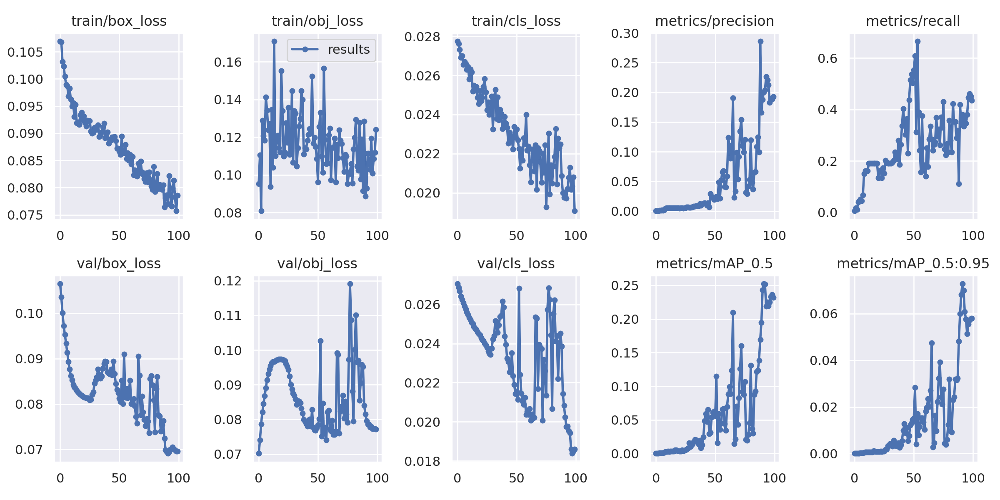

In [ ]:
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename=HOME+'/yolov5/runs/train/yolov5s_results/results.png', width=1000)  # view results.png

GROUND TRUTH VALIDATION DATA:


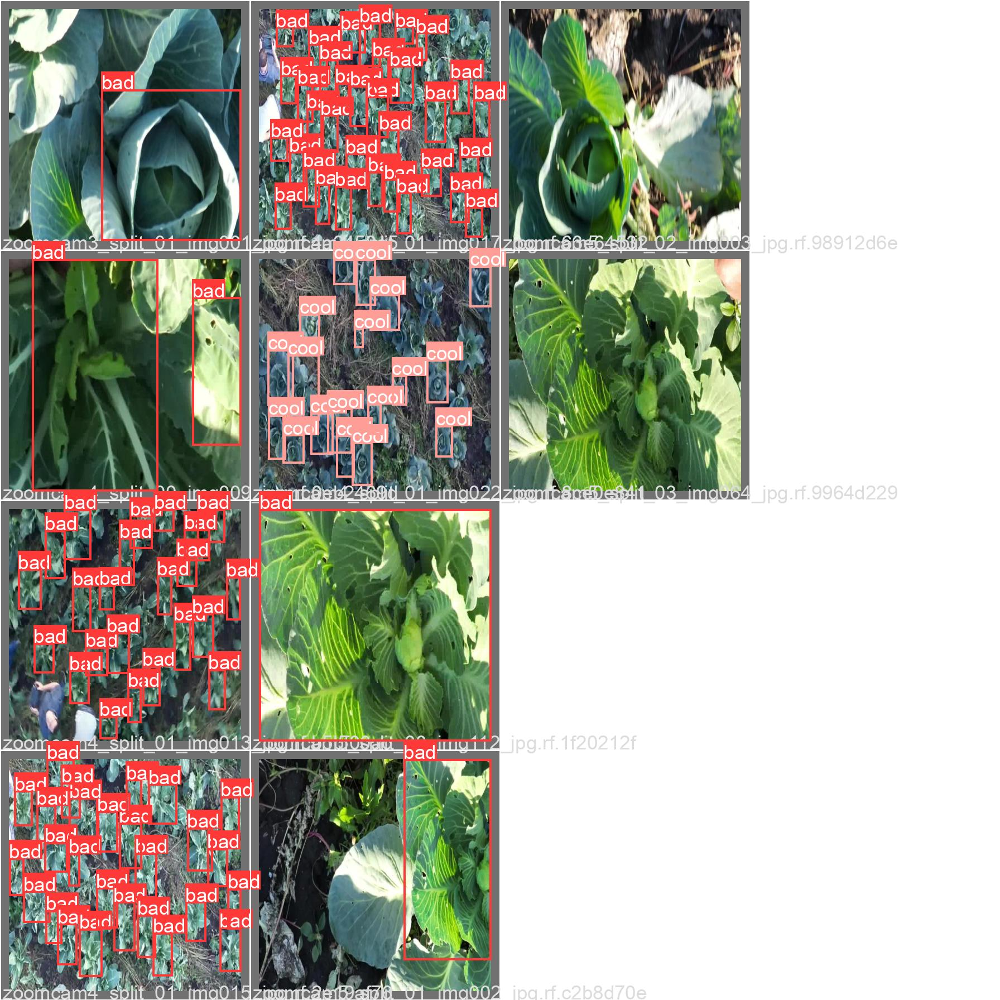

In [ ]:
# first, display our ground truth data

print("GROUND TRUTH VALIDATION DATA:")
Image(filename=HOME+'/yolov5/runs/train/yolov5s_results/val_batch0_labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


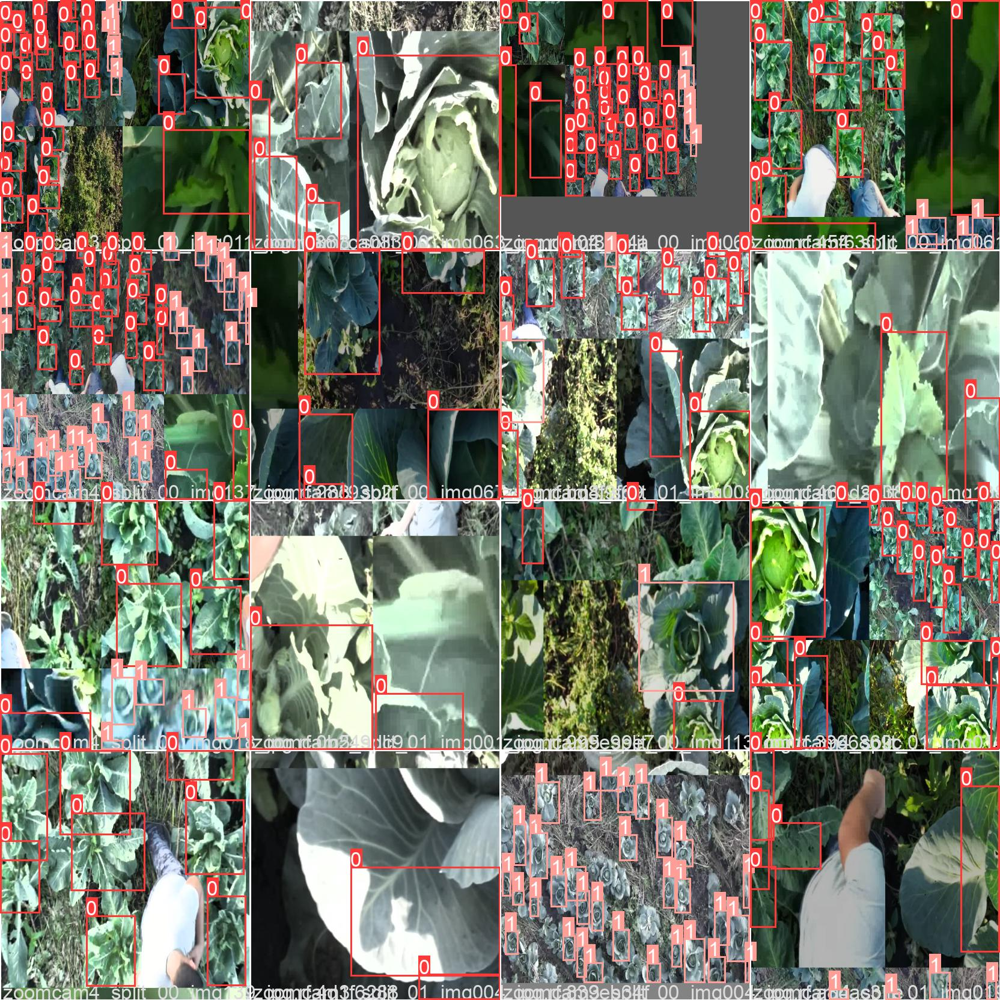

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename=HOME+'/yolov5/runs/train/yolov5s_results/train_batch0.jpg', width=900)

In [ ]:
# trained weights are saved by default in our weights folder
%ls runs/

train/


In [ ]:
%ls runs/train/yolov5s_results/weights

best.pt  last.pt


In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd {HOME}/yolov5
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source {dataset.location}/valid/images

/content/yolov5
detect: weights=['runs/train/yolov5s_results/weights/best.pt'], source=/content/yolov5/Cabbage2-3/valid/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-306-gfbe67e4 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 232 layers, 7249215 parameters, 0 gradients, 16.7 GFLOPs
image 1/10 /content/yolov5/Cabbage2-3/valid/images/zoomcam3_split_01_img001_jpg.rf.4a2458a5e1ac160b0c1f3897a414c151.jpg: 416x416 Done. (0.008s)
image 2/10 /content/yolov5/Cabbage2-3/valid/images/zoomcam4_split_00_img009_jpg.rf.0eb2469dec8c6fe8024def0f6aa753ff.jpg: 416x416 Done. (0.008s)
image 3/10 /cont

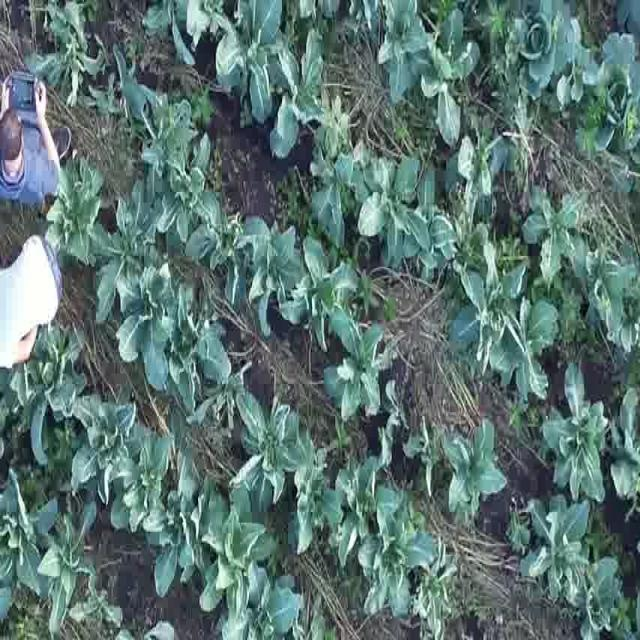

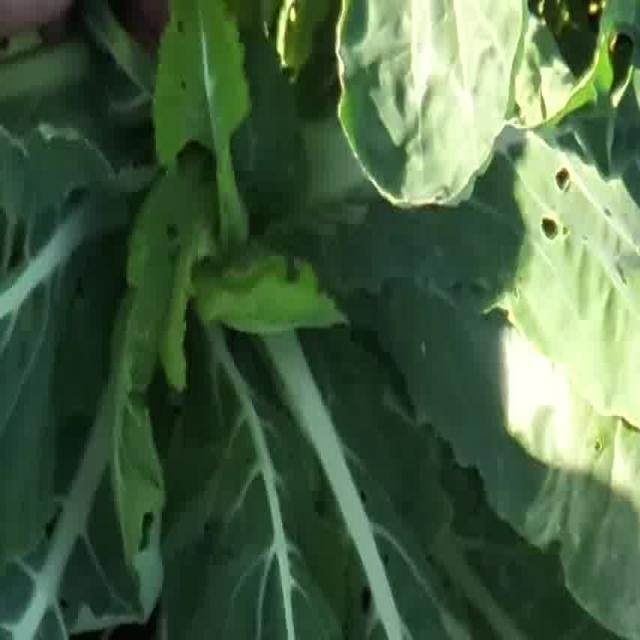

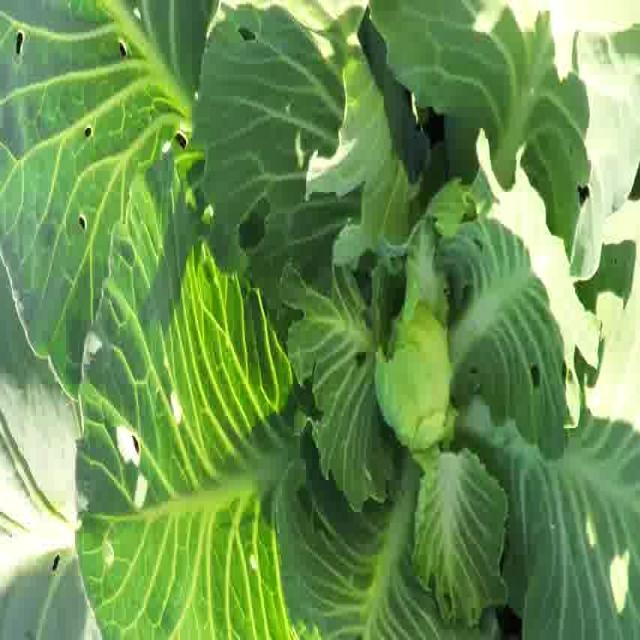

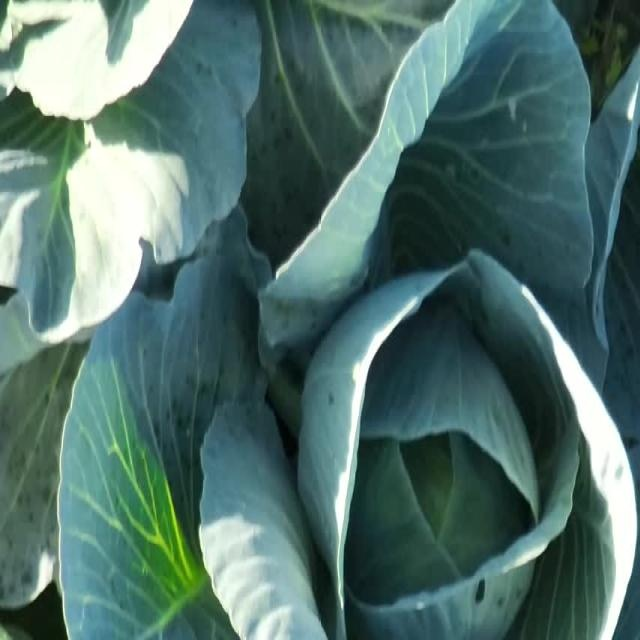

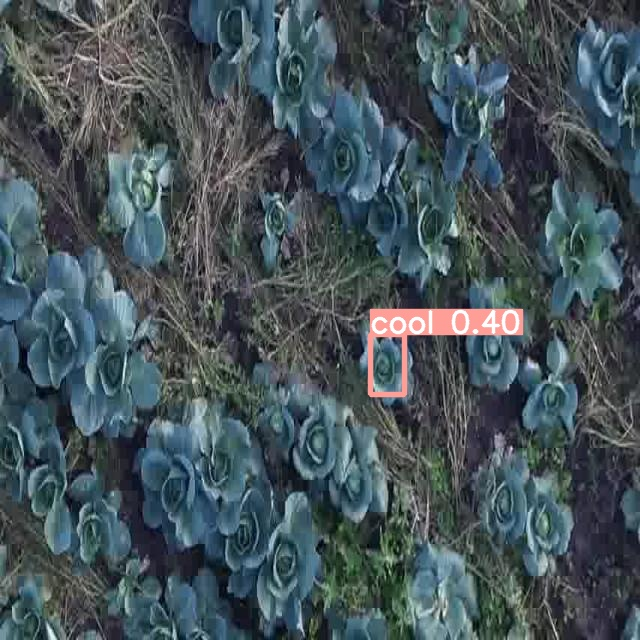

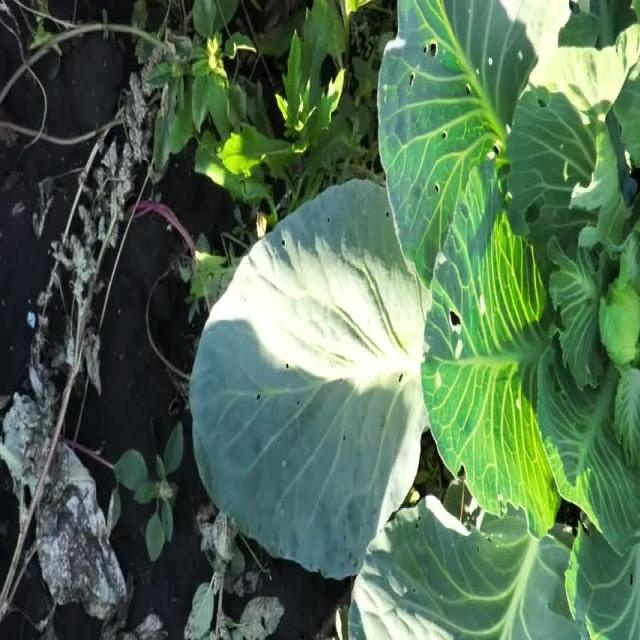

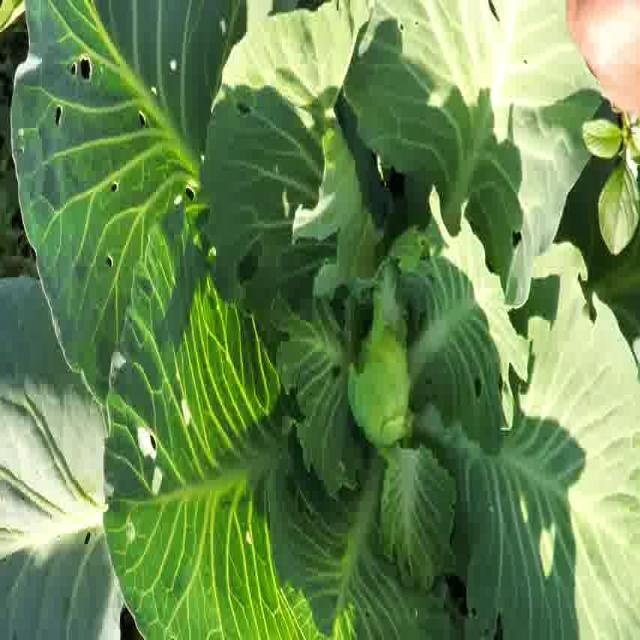

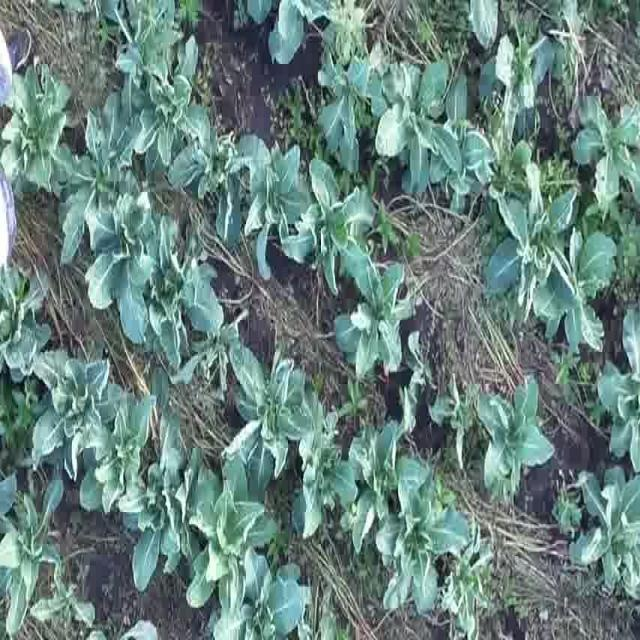

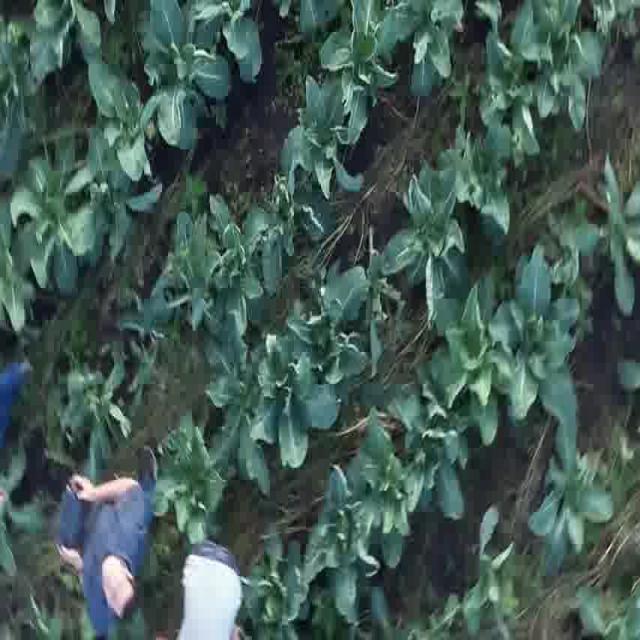

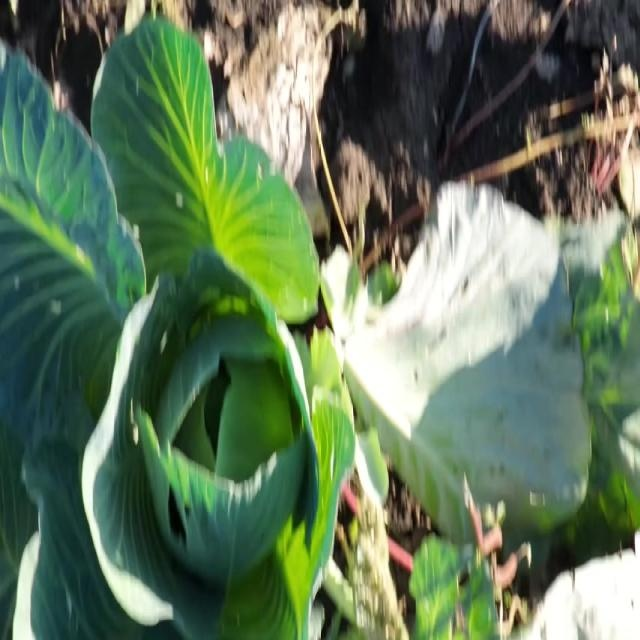

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob(HOME+'/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
!find . -name yolov5s_results -print

./runs/train/yolov5s_results


In [ ]:
!ls -lh ./runs/train/yolov5s_results/

total 5.1M
-rw-r--r-- 1 root root  92K Aug 29 15:58 confusion_matrix.png
-rw-r--r-- 1 root root 1.1M Aug 29 15:58 events.out.tfevents.1693324564.05b0d4e2de4a.1248.0
-rw-r--r-- 1 root root  98K Aug 29 15:58 F1_curve.png
-rw-r--r-- 1 root root  373 Aug 29 15:56 hyp.yaml
-rw-r--r-- 1 root root 197K Aug 29 15:56 labels_correlogram.jpg
-rw-r--r-- 1 root root 174K Aug 29 15:56 labels.jpg
-rw-r--r-- 1 root root  679 Aug 29 15:56 opt.yaml
-rw-r--r-- 1 root root 115K Aug 29 15:58 P_curve.png
-rw-r--r-- 1 root root  91K Aug 29 15:58 PR_curve.png
-rw-r--r-- 1 root root  97K Aug 29 15:58 R_curve.png
-rw-r--r-- 1 root root  29K Aug 29 15:58 results.csv
-rw-r--r-- 1 root root 301K Aug 29 15:58 results.png
-rw-r--r-- 1 root root 639K Aug 29 15:56 train_batch0.jpg
-rw-r--r-- 1 root root 689K Aug 29 15:56 train_batch1.jpg
-rw-r--r-- 1 root root 632K Aug 29 15:56 train_batch2.jpg
-rw-r--r-- 1 root root 458K Aug 29 15:58 val_batch0_labels.jpg
-rw-r--r-- 1 root root 442K Aug 29 15:58 val_batch0_pred.jpg
d

In [ ]:
!file ./runs/train/yolov5s_results/events.out.tfevents.*

./runs/train/yolov5s_results/events.out.tfevents.1693324564.05b0d4e2de4a.1248.0: data


./runs/train/yolov5s_results/train_batch2.jpg


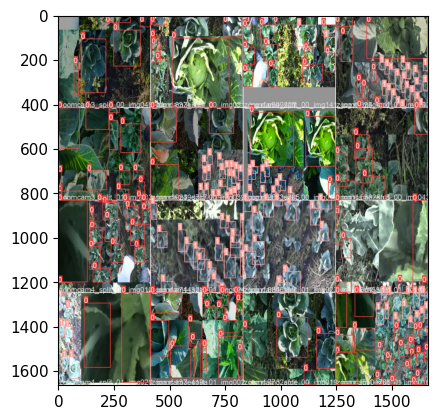

./runs/train/yolov5s_results/train_batch0.jpg


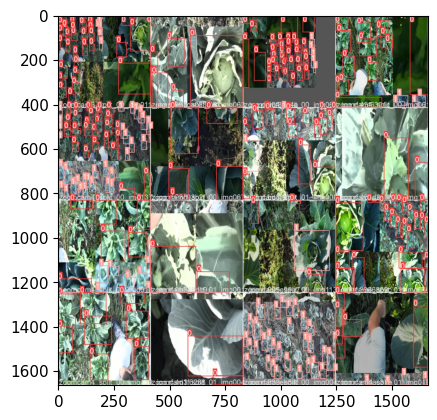

./runs/train/yolov5s_results/train_batch1.jpg


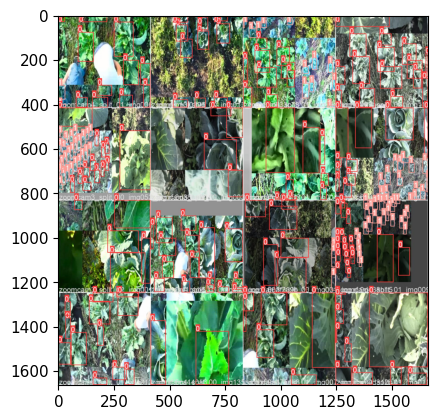

./runs/train/yolov5s_results/labels.jpg


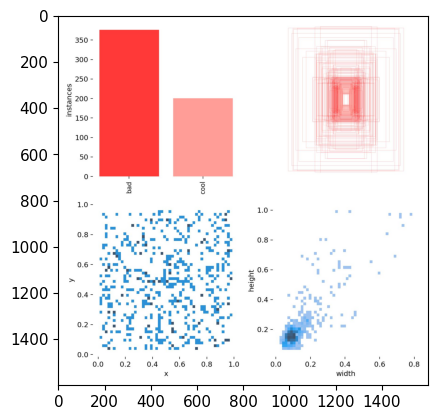

./runs/train/yolov5s_results/labels_correlogram.jpg


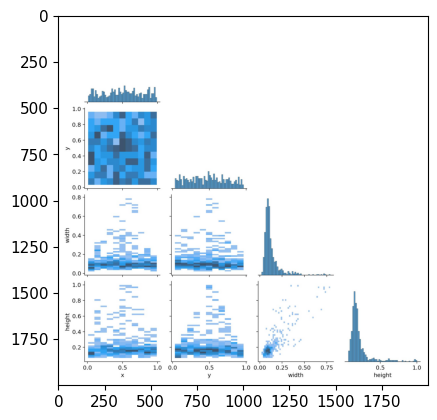

./runs/train/yolov5s_results/val_batch0_pred.jpg


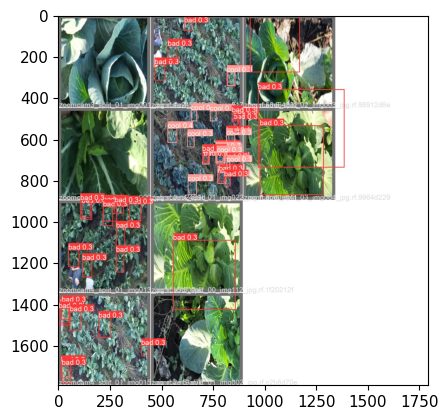

./runs/train/yolov5s_results/val_batch0_labels.jpg


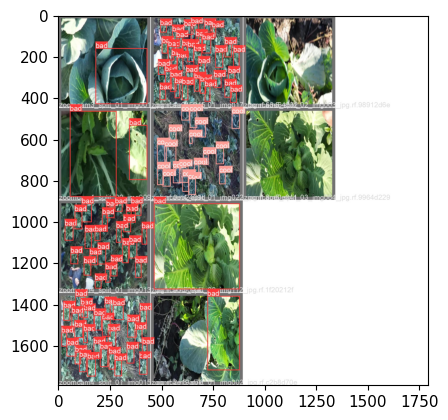

In [ ]:
import os
import matplotlib.pyplot as plt
%matplotlib inline
directory = './runs/train/yolov5s_results/' # путь к нужному каталогу здесь
# Проходимся по каталогу и выводим на экран все JPG файлы
for filename in os.listdir(directory):
    if filename.endswith('.jpg'):
        img_path = os.path.join(directory, filename)
        print(img_path)
        img = plt.imread(img_path)
        plt.imshow(img)
        plt.show()

-------------

In [ ]:
%cd {HOME}/yolov5/
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --source '/content/drive/MyDrive/УИИ/Base/mp4/zoomcam2_split_01.mp4'

/content/yolov5
detect: weights=['runs/train/yolov5s_results/weights/best.pt'], source=/content/drive/MyDrive/УИИ/Base/mp4/zoomcam2_split_01.mp4, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-306-gfbe67e4 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 232 layers, 7249215 parameters, 0 gradients, 16.7 GFLOPs
video 1/1 (1/1950) /content/drive/MyDrive/УИИ/Base/mp4/zoomcam2_split_01.mp4: 384x640 Done. (0.080s)
video 1/1 (2/1950) /content/drive/MyDrive/УИИ/Base/mp4/zoomcam2_split_01.mp4: 384x640 Done. (0.012s)
video 1/1 (3/1950) /content/drive/MyDrive/УИИ/Base/mp4/zoomcam2_split_01.mp4: 384x6

In [ ]:
import cv2
import numpy as np
from IPython.display import YouTubeVideo
from IPython.display import HTML
from IPython.display import Video

In [ ]:
!pip install moviepy

In [ ]:
from moviepy.editor import *

In [ ]:
!ls -l /content/yolov5/runs/detect/exp3/zoomcam3_split_01.mp4

ls: cannot access '/content/yolov5/runs/detect/exp3/zoomcam3_split_01.mp4': No such file or directory


In [ ]:
Video('/content/drive/MyDrive/УИИ/Base/mp4/z_output_1.mp4', embed=True, html_attributes="controls muted autoplay")

In [ ]:
Video('/content/drive/MyDrive/УИИ/Base/mp4/z_output_2.mp4', embed=True, html_attributes="controls muted autoplay")